In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy import special
from matplotlib.animation import FuncAnimation
from IPython import display

In [2]:
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']
plt.rcParams['font.size'] = 22
plt.rcParams['axes.linewidth'] = 2
plt.rc('font', **{'family': 'serif', 'serif': ['Times']})
plt.rc('text', usetex=True)

In [70]:
def psi0(omega, x, n):
    hermite_pol = special.hermite(n, monic=False)
    return (1/np.sqrt(2**n*special.factorial(n)))*\
            (omega/np.pi)**(1/4)*np.exp(-omega*x**2/2)*hermite_pol(np.sqrt(omega)*x)

def SchrodingerRK2(tf, dt, r, L, omega, n, k0):
    
    dx = np.sqrt(dt/(2*r))
    x = -np.arange(-L,L,dx)
    t = np.arange(0,tf+dt,dt)
    tsize = len(t) ; xsize = len(x) 

    R = np.zeros( (xsize,tsize) ) #Parte real
    I = np.zeros( (xsize,tsize) ) #Parte complexa
    Psi = np.zeros( (xsize,tsize), dtype=np.complex64 )
    V = (1/2)*(omega*x)**2
    
    k1I = np.zeros( xsize ) # k1 da parte imaginaria
    k1R = np.zeros( xsize ) # k1 da parte real
    k2I = np.zeros( xsize ) # k2 da parte imaginaria
    k2R = np.zeros( xsize ) # k2 da parte real

    #valores de meio passo
    R12 = np.zeros(xsize)
    I12 = np.zeros(xsize)
    
    #parte real e imaginaria da hamiltoniana para posterior calculo da energia
    HR = np.zeros( (xsize, tsize) )
    HI = np.zeros( (xsize, tsize) )

    E = np.zeros(tsize, dtype=np.complex64)

    N = np.zeros(tsize) # Integral mostrando a normalizacao
    
    #definindo as condicoes iniciais da funcao de onda
    Psi[:,0] = psi0(omega, x, n)*np.exp(1j*k0*x)
    R[:,0] = Psi[:,0].real
    I[:,0] = Psi[:,0].imag
    
    #loop no tempo para Runge Kutta
    for n in range(tsize-1):
        #impondo as condicoes de contorno
        I[0,:]  = 0
        I[-1,:] = 0
        R[0,:]  = 0
        R[-1,:] = 0
        
        #normalmente utiliza-se um loop espacial alem do loop temporal, mas utilizando
        #slicing de arrays, é possivel evitar os loops espaciais, otimizando o algoritmo
        
        #calculando os k1R's
        k1R[1:-1] = -r*(I[2:,n] - 2*I[1:-1, n] + I[:-2, n]) + V[1:-1]*I[1:-1,n]*dt
        k1R[0]    = -r*(I[1,n] - 2*I[0,n] + I[-1,n]) + V[0]*I[0,n]*dt
        k1R[-1]   = -r*(I[0,n] - 2*I[-1,n] + I[-2,n]) + V[-1]*I[-1,n]*dt
        
        #calculando os k1I's
        k1I[1:-1] = +r*(R[2:,n] - 2*R[1:-1,n] + R[:-2,n] ) - V[1:-1]*R[1:-1,n]*dt
        k1I[0]    = +r*(R[1,n] - 2*R[0,n] + R[-1,n]) - V[0]*R[0,n]*dt
        k1I[-1]   = +r*(R[0,n] - 2*R[-1,n] + R[-2,n]) - V[-1]*R[-1,n]*dt
        
        #calculando os valores de meio passo
        R12       = R[:,n] + k1R/2
        I12       = I[:,n] + k1I/2
        
        #calculando k2R's
        k2R[1:-1] = -r*(I12[2:] - 2*I12[1:-1] + I12[:-2]) + V[1:-1]*I12[1:-1]*dt
        k2R[0]    = -r*(I12[1] - 2*I12[0] + I12[-1]) + V[0]*I12[0]*dt
        k2R[-1]   = -r*(I12[0] - 2*I12[-1] + I12[-2]) + V[-1]*I12[-1]*dt
        
        #calculando k2I's
        k2I[1:-1] = +r*(R12[2:] - 2*R12[1:-1] + R12[:-2]) - V[1:-1]*R12[1:-1]*dt
        k2I[0]    = +r*(R12[1] - 2*R12[0] + R12[-1]) - V[0]*R12[0]*dt
        k2I[-1]   = +r*(R12[0] - 2*R12[-1] + R12[-2]) - V[-1]*R12[-1]*dt 
        
        #calculando as iteracoes de R e I
        R[:,n+1] = R[:,n] + k2R
        I[:,n+1] = I[:,n] + k2I
        R[:,-1]  = R[:,-2] + k2R
        I[:,-1]  = I[:,-2] + k2I
        
        #reimpondo as condicoes de contorno
        I[0,:]   = 0
        I[-1,:]  = 0
        R[0,:]   = 0
        R[-1,:]  = 0

        #calculando HI
        HR[1:-1,n] = -(1/(2*dx**2))*( R[2:,n] - 2*R[1:-1,n] + R[:-2,n] ) + V[1:-1]*R[1:-1,n]
        HR[-1,n]   = -(1/(2*dx**2))*( R[0,n] - 2*R[-1,n] + R[-2,n] ) + V[-1]*R[-1,n]
        HR[0,n]    = -(1/(2*dx**2))*( R[1,n] - 2*R[0,n] + R[-1,n] ) + V[0]*R[0,n]
        
        #calculando HR
        HI[1:-1,n] = -(1/(2*dx**2))*( I[2:,n] - 2*I[1:-1,n] + I[:-2,n] ) + V[1:-1]*I[1:-1,n]
        HI[0,n]    = -(1/(2*dx**2))*( I[-1,n] - 2*I[0,n] + I[1,n] ) + V[0]*I[0,n]
        HI[-1,n]   = -(1/(2*dx**2))*( I[-2,n] - 2*I[-1,n] + I[0,n] ) + V[-1]*I[-1,n]

    #calculando HR no ultimo termo temporal
    HR[1:-1,-1] = -(1/2)*((R[2:,-1] - 2*R[1:-1,-1] + R[:-2,-1])/(dx**2)) + V[1:-1]*R[1:-1,-1]
    HR[0,-1]    = -(1/2)*((R[1,n] - 2*R[0,-1] + R[-1,-1])/(dx**2)) + V[0]*R[0,-1]
    HR[-1,-1]   = -(1/2)*((R[0,n] - 2*R[-1,-1] + R[-2, -1])/(dx**2)) + V[-1]*R[-1,-1]
    
    #calculando HI no ultimo termo temporal
    HI[1:-1,-1] = -(1/2)*((I[2:,-1] - 2*I[1:-1,-1] + I[:-2,-1])/(dx**2)) + V[1:-1]*I[1:-1,-1]
    HI[0,-1]    = -(1/2)*((I[1,-1] - 2*I[0,-1] + I[-1,-1])/(dx**2)) + V[0]*I[0,-1]
    HI[-1,-1]   = -(1/2)*((I[0,-1] - 2*I[-1,-1] + I[-2,-1])/(dx**2)) + V[-1]*I[-1,-1]
    
    #definindo a funcao de onda a partir da parte real R e imaginaria I
    Psi = R + 1j*I
    
    #calculando a normalizacao da funcao de onda
    N = np.trapz(np.abs(Psi)**2, dx=dx, axis=0)
    
    #calculando a energia a partir da funcao de onda e das hamiltonianas
    E = np.trapz(np.conjugate(Psi)*(HR + 1j*HI), dx=dx, axis=0 ) / N
    
    return (Psi, N, E, V, x, t, xsize, tsize)

In [71]:
Psi0 = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=0, k0=0)[0]
Psi1 = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=1, k0=0)[0]
Psi2 = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=2, k0=0)[0]
Psi3 = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=3, k0=0)[0]
Psi4 = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=4, k0=0)[0]
Psi5 = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=5, k0=0)[0]
Psi6 = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=6, k0=0)[0]
Psi7 = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=7, k0=0)[0]

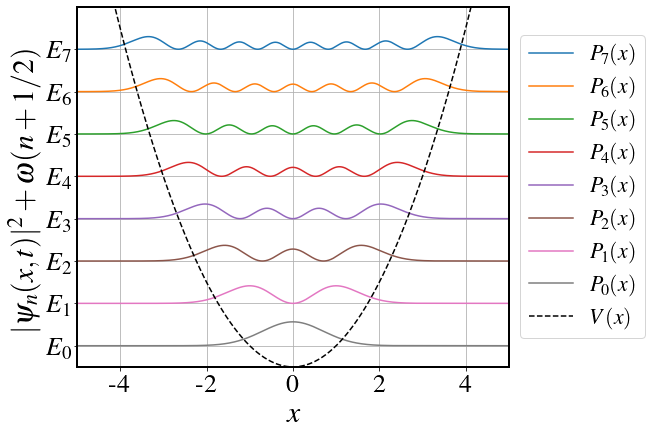

In [73]:
x = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=0, k0=0)[-4]
V = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=0, k0=0)[3]

fig = plt.figure(figsize=(6,5))
ax = fig.add_axes([0,0,1,1])

ax.plot(x, 1*7.5 + np.abs(Psi7[:,10])**2, label=r'$P_7(x)$')
ax.plot(x, 1*6.5 + np.abs(Psi6[:,10])**2, label=r'$P_6(x)$')
ax.plot(x, 1*5.5 + np.abs(Psi5[:,10])**2, label=r'$P_5(x)$')
ax.plot(x, 1*4.5 + np.abs(Psi4[:,10])**2, label=r'$P_4(x)$')
ax.plot(x, 1*3.5 + np.abs(Psi3[:,10])**2, label=r'$P_3(x)$')
ax.plot(x, 1*2.5 + np.abs(Psi2[:,10])**2, label=r'$P_2(x)$')
ax.plot(x, 1*1.5 + np.abs(Psi1[:,10])**2, label=r'$P_1(x)$')
ax.plot(x, 1*0.5 + np.abs(Psi0[:,10])**2, label=r'$P_0(x)$')
ax.plot(x, V, color='black', linestyle='dashed', label=r'$V(x)$')

ax.set_xlim(-5,5)
ax.set_ylim(0,8.5)
ax.set_yticks([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5])
ax.set_yticklabels([r'$E_0$', r'$E_1$', r'$E_2$', r'$E_3$', r'$E_4$', r'$E_5$', r'$E_6$', r'$E_7$'], fontsize=26)
ax.set_xticks([-4, -2, 0, 2, 4])
ax.set_xticklabels([-4, -2, 0, 2, 4], fontsize=26)
ax.set_xlabel(r'$x$', fontsize=30)
ax.set_ylabel(r'$|\psi_n(x,t)|^2 + \omega (n + 1/2)$', fontsize=30)
ax.grid()
ax.legend(loc='center left', bbox_to_anchor=(1,0.5))
plt.savefig('eigens_pdf.png', dpi=500, bbox_inches='tight')

plt.show()

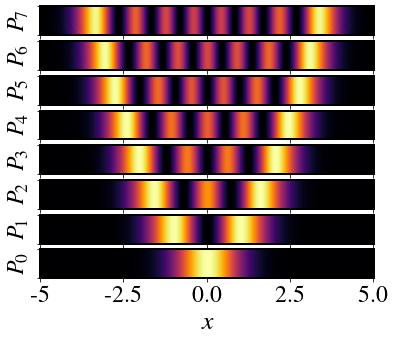

In [74]:
fig, ax = plt.subplots(nrows = 8, ncols = 1, sharex = True, sharey=False, figsize=(6,5))

ax[0].imshow(np.abs(np.transpose(Psi7))**2, aspect='auto', cmap='inferno')
ax[1].imshow(np.abs(np.transpose(Psi6))**2, aspect='auto', cmap='inferno')
ax[2].imshow(np.abs(np.transpose(Psi5))**2, aspect='auto', cmap='inferno')
ax[3].imshow(np.abs(np.transpose(Psi4))**2, aspect='auto', cmap='inferno')
ax[4].imshow(np.abs(np.transpose(Psi3))**2, aspect='auto', cmap='inferno')
ax[5].imshow(np.abs(np.transpose(Psi2))**2, aspect='auto', cmap='inferno')
ax[6].imshow(np.abs(np.transpose(Psi1))**2, aspect='auto', cmap='inferno')
ax[7].imshow(np.abs(np.transpose(Psi0))**2, aspect='auto', cmap='inferno')

ax[0].set_ylabel(r'$P_7$', fontsize=24)
ax[1].set_ylabel(r'$P_6$', fontsize=24)
ax[2].set_ylabel(r'$P_5$', fontsize=24)
ax[3].set_ylabel(r'$P_4$', fontsize=24)
ax[4].set_ylabel(r'$P_3$', fontsize=24)
ax[5].set_ylabel(r'$P_2$', fontsize=24)
ax[6].set_ylabel(r'$P_1$', fontsize=24)
ax[7].set_ylabel(r'$P_0$', fontsize=24)

ax[0].set_yticklabels([])
ax[1].set_yticklabels([])
ax[2].set_yticklabels([])
ax[3].set_yticklabels([])
ax[4].set_yticklabels([])
ax[5].set_yticklabels([])
ax[6].set_yticklabels([])
ax[7].set_yticklabels([])

ax[7].set_xticks([0, 306, 613, 916, 1220])
ax[7].set_xticklabels(['-5', '-2.5', '0.0', '2.5', '5.0' ], fontsize=24)
ax[7].set_xlabel(r'$x$', fontsize=26)

plt.savefig('pdf_eigens.png', dpi=500, bbox_inches='tight')

plt.show()

In [308]:
Ergs = np.array([SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=1, omega=50, n=i, k0=0)[2][0] for i in range(8)])
Ergs_final = np.array([SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=1, omega=50, n=i, k0=0)[2][-1] for i in range(8)])

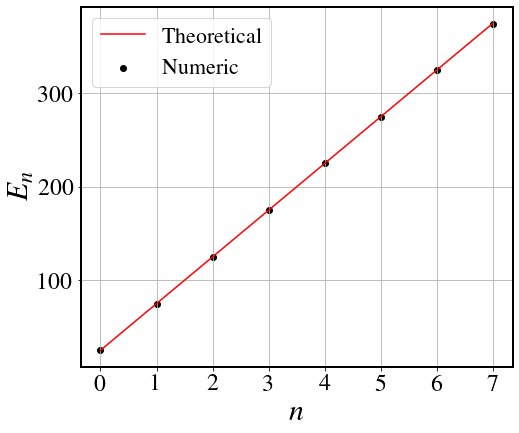

In [309]:
fig = plt.figure(figsize=(6,5))
ax1 = fig.add_axes([0,0,1,1])
n = np.arange(0,8,1)
ax1.plot(n, [50*0.5, 50*1.5, 50*2.5, 50*3.5, 50*4.5, 50*5.5, 50*6.5, 50*7.5], color='red', label='Theoretical')
ax1.scatter(n, Ergs.real, color='black', label='Numeric')
ax1.set_xlabel(r'$n$',fontsize=30)
ax1.set_ylabel(r'$E_n$', fontsize=30)
ax1.set_xticks([0, 1, 2, 3, 4, 5, 6, 7])
ax1.set_yticks([100, 200, 300])
ax1.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '7'], fontsize=24)
ax1.set_yticklabels(['100', '200', '300'], fontsize=24)
plt.legend()
plt.grid()

plt.savefig('energy_modes.png', dpi=500, bbox_inches='tight')

plt.show()

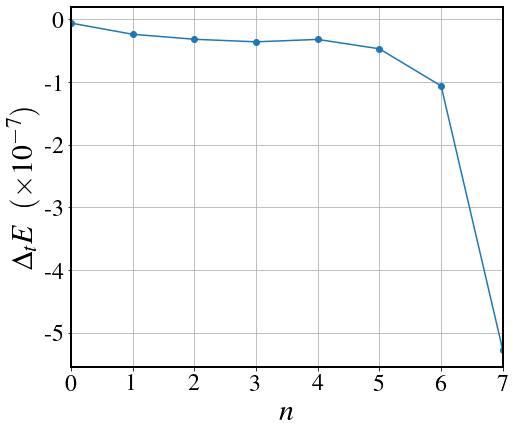

In [326]:
fig = plt.figure(figsize=(6,5))
ax1 = fig.add_axes([0,0,1,1])
n = np.arange(0,8,1)
ax1.plot(n, (Ergs - Ergs_final).real, 'o-')
ax1.set_xlim(0,7)
ax1.set_xlabel(r'$n$', fontsize=30)
ax1.set_ylabel(r'$\Delta_t E \;\; (\times 10^{-7})$', fontsize=30)
ax1.set_xticks([0,1,2,3,4,5,6,7])
ax1.set_xticklabels([0,1,2,3,4,5,6,7], fontsize=24)
ax1.set_yticks([1e-7*0,1e-7*-1,1e-7*-2,1e-7*-3,1e-7*-4,1e-7*-5])
ax1.set_yticklabels([0,-1,-2,-3,-4,-5], fontsize=24)
ax1.grid()
plt.savefig('delta_ergs.png', dpi=500, bbox_inches='tight')
plt.show()

In [77]:
Ns1 = np.array([SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=1, omega=50, n=i, k0=0)[1][0] for i in range(31)])

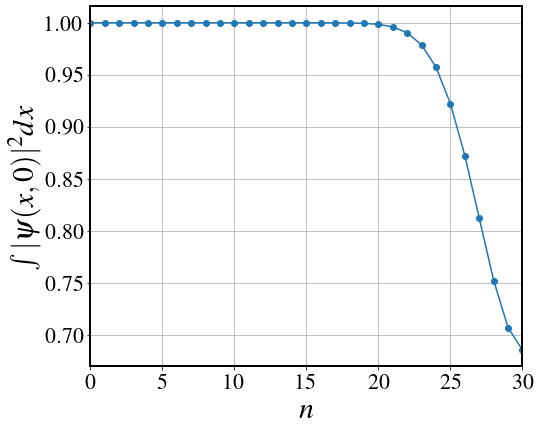

In [299]:
fig = plt.figure(figsize=(6,5))
ax = fig.add_axes([0,0,1,1])
n = np.arange(0,31,1)
ax.plot(n, Ns1, 'o-')
ax.set_xlabel(r'$n$', fontsize=30)
ax.set_ylabel(r'$\int |\psi(x,0)|^2 dx$', fontsize=30)
ax.set_xlim(0,30)
ax.grid()
plt.savefig('normalization_vs_n.png', dpi=500, bbox_inches='tight')
plt.show()

# Checking uncertainty principle

Standard deviation of momentum operator is given by
$$\sigma_p = \sqrt{\mathbb{E}[p^2] - \mathbb{E}[p]^2}$$
Similarly, for the position operator $x$, we have
$$ \sigma_x = \sqrt{\mathbb{E}[x^2] - \mathbb{E}[x]^2} $$

In configuration space the operator $p$ is given by $-i \partial/ \partial x$. Therefore, the expected value of $p$ is
$$ \mathbb{E}[p] =-i \int_{-\infty}^{+\infty} \psi^*(x,0) \frac{\partial}{\partial x} \psi(x,0) dx $$
The second moment of the PDF is 
$$ \mathbb{E}[p^2] = -\int_{-\infty}^{+\infty} \psi^*(x,0)  \frac{\partial^2}{\partial x^2} \psi(x,0) dx $$

For operator $x$ we have
$$\mathbb{E}[x] = \int_{-\infty}^{+\infty} \psi^*(x,0) x \psi(x,0) dx$$
and
$$\mathbb{E}[x^2] = \int_{-\infty}^{+\infty} \psi^*(x,0) x^2 \psi(x,0) dx$$
By uncertainty principle,
$$\sigma_x \sigma_p \geq \frac{1}{2}$$

In quantum harmonic oscillator we have
$$\sigma_x \sigma_p = n + \frac{1}{2}$$
which is indeed bigger than 1/2, since $n=0,1,2,...$

In [79]:
def uncertainty(Psi, dt, r):
    dx = np.sqrt(dt/(2*r))
    diff_Psi = np.gradient(Psi[:,0], dx )  #first derivative
    diff2_Psi = np.gradient(diff_Psi, dx ) #second derivative

    mean_p = -1j*np.trapz(np.conjugate(Psi[:,0])*diff_Psi, dx=dx )
    mean_p2 = -np.trapz(np.conjugate(Psi[:,0])*diff2_Psi, dx=dx )
    mean_x = np.trapz(np.conjugate(Psi[:,0])*x*Psi[:,0], dx=dx )
    mean_x2 = np.trapz(np.conjugate(Psi[:,0])*(x**2)*Psi[:,0], dx=dx )

    sigma_x = np.sqrt( mean_x2 - mean_x**2 )
    sigma_p = np.sqrt( mean_p2 - mean_p**2 )

    return (sigma_x*sigma_p, mean_p, mean_p2, mean_x, mean_x2)

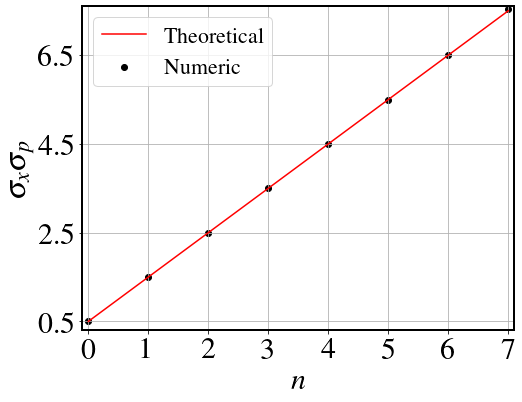

In [80]:
fig = plt.figure(figsize=(6,5))
ax1 = fig.add_axes([0,0,1,0.9])

n = np.arange(0,8,1)
ax1.scatter(n, [uncertainty(Psi=Psi0, dt=0.00001, r=0.075)[0].real,
           uncertainty(Psi=Psi1, dt=0.00001, r=0.075)[0].real,
           uncertainty(Psi=Psi2, dt=0.00001, r=0.075)[0].real,
           uncertainty(Psi=Psi3, dt=0.00001, r=0.075)[0].real,
           uncertainty(Psi=Psi4, dt=0.00001, r=0.075)[0].real,
           uncertainty(Psi=Psi5, dt=0.00001, r=0.075)[0].real,
           uncertainty(Psi=Psi6, dt=0.00001, r=0.075)[0].real,
           uncertainty(Psi=Psi7, dt=0.00001, r=0.075)[0].real], color='black', label='Numeric')
ax1.plot(n, n+(1/2), color='red', label='Theoretical')
ax1.set_xlabel(r'$n$', fontsize=30)
ax1.set_ylabel(r'$\sigma_x \sigma_p$', fontsize=30)
ax1.set_xticks([0,1,2,3,4,5,6,7])
ax1.set_xticklabels(['0', '1', '2', '3', '4', '5', '6' ,'7'], fontsize=30)
ax1.set_yticks([0.5, 2.5, 4.5, 6.5, 8.5])
ax1.set_yticklabels(['0.5', '2.5', '4.5', '6.5', '8.5'], fontsize=30)
ax1.set_xlim(-0.1,7.1)
ax1.set_ylim(0.3, 7.6)
ax1.grid()
ax1.legend()

plt.savefig('sigma_xsigma_p.png', dpi=500, bbox_inches='tight')

plt.show()

# Ehrenfest Theorem

The probability density function associated with the classical harmonic oscillator with energy $E_n = (n + 1/2)\omega$ is

$$ \mathbb{P}(x) = \frac{1}{\pi} \frac{1}{\sqrt{A^2 - x^2}} $$

where $A$ is the amplitude of the oscillation. The same probability function from the quantum oscillator is given by

$$ \mathbb{P}(x) = \int_{-\infty}^{+\infty} \phi^*(x)\phi(x)dx $$

The amplitude $A$ of the classical oscillator is proportional to the energy that it is given to it. Then,

$$ A = \sqrt{\frac{2}{\omega} \left( n + \frac{1}{2} \right)} $$ 

<ipython-input-138-23cf8966a68f>:8: RuntimeWarning: invalid value encountered in sqrt
  ax1.plot(x, (1/np.pi)*(1/(np.sqrt(A**2 - x**2))), linestyle='dashed', label='Classical', color='red')


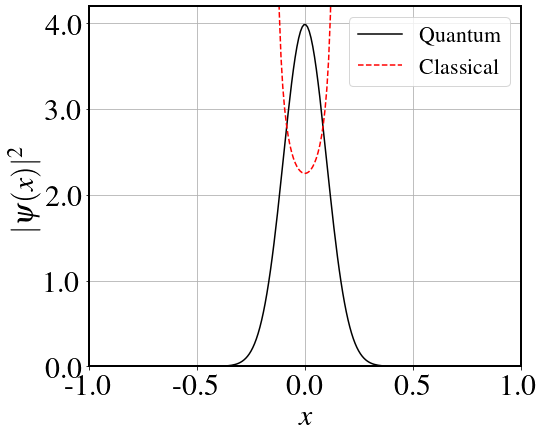

In [138]:
Psi0 = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=1, omega=50, n=0)[0]
x = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=1, omega=50, n=11)[4]
A = np.sqrt((2/50)*(0 + 1/2))
fig = plt.figure(figsize=(6,5))
ax1 = fig.add_axes([0,0,1,1])

ax1.plot(x , np.abs(Psi0[:,0])**2, label='Quantum', color='black')
ax1.plot(x, (1/np.pi)*(1/(np.sqrt(A**2 - x**2))), linestyle='dashed', label='Classical', color='red')
ax1.set_xlabel(r'$x$', fontsize=30)
ax1.set_ylabel(r'$|\psi(x)|^2$', fontsize=30)
ax1.grid()
ax1.set_xlim(-1,1)
ax1.set_ylim(0,4.2)
ax1.set_xticklabels(['-1.0', '-0.5', '0.0', '0.5', '1.0'],fontsize=30)
ax1.set_yticklabels(['0.0', '1.0', '2.0', '3.0', '4.0'],fontsize=30)
ax1.legend()

plt.savefig('quantum_classical_n=0.png', dpi=500, bbox_inches='tight')

plt.show()

<ipython-input-140-f59684cb5c71>:8: RuntimeWarning: invalid value encountered in sqrt
  ax1.plot(x, (1/np.pi)*(1/(np.sqrt(A**2 - x**2))), linestyle='dashed', label='Classical', color='red')


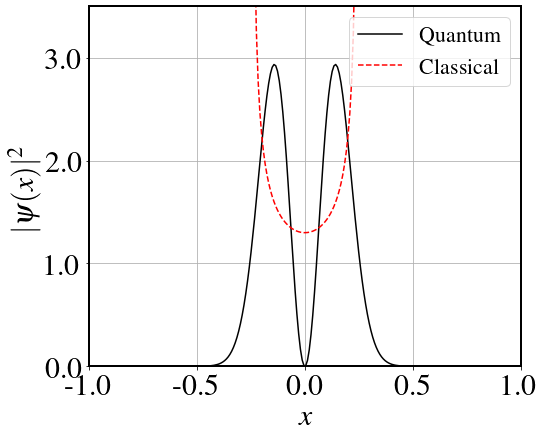

In [140]:
Psi1 = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=1, omega=50, n=1)[0]
x = SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=1, omega=50, n=1)[4]
A = np.sqrt((2/50)*(1 + 1/2))
fig = plt.figure(figsize=(6,5))
ax1 = fig.add_axes([0,0,1,1])

ax1.plot(x , np.abs(Psi1[:,0])**2, label='Quantum', color='black')
ax1.plot(x, (1/np.pi)*(1/(np.sqrt(A**2 - x**2))), linestyle='dashed', label='Classical', color='red')
ax1.set_xlabel(r'$x$', fontsize=30)
ax1.set_ylabel(r'$|\psi(x)|^2$', fontsize=30)
ax1.grid()
ax1.set_xlim(-1,1)
ax1.set_ylim(0,3.5)
ax1.set_yticks([0, 1, 2, 3])
ax1.set_xticklabels(['-1.0', '-0.5', '0.0', '0.5', '1.0'],fontsize=30)
ax1.set_yticklabels(['0.0', '1.0', '2.0', '3.0'],fontsize=30)
ax1.legend()

plt.savefig('quantum_classical_n=1.png', dpi=500, bbox_inches='tight')

plt.show()

<ipython-input-141-ce92b8c81d58>:8: RuntimeWarning: invalid value encountered in sqrt
  ax1.plot(x, (1/np.pi)*(1/(np.sqrt(A**2 - x**2))), linestyle='dashed', label='Classical', color='red')


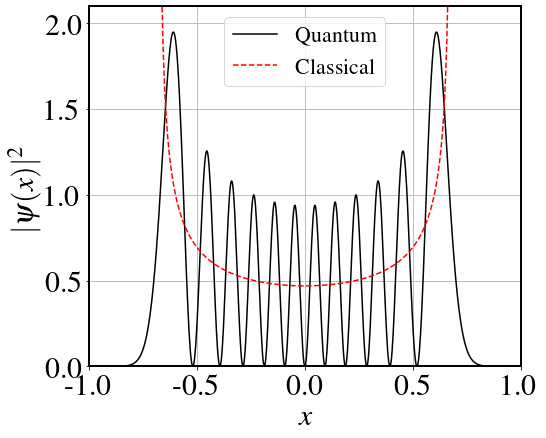

In [141]:
Psi11 = SchrodingerRK2(tf=0.05, dt=0.000001, r=0.075, L=1, omega=50, n=11)[0]
x = SchrodingerRK2(tf=0.05, dt=0.000001, r=0.075, L=1, omega=50, n=11)[4]
A = np.sqrt((2/50)*(11 + 1/2))
fig = plt.figure(figsize=(6,5))
ax1 = fig.add_axes([0,0,1,1])

ax1.plot(x , np.abs(Psi11[:,0])**2, label='Quantum', color='black')
ax1.plot(x, (1/np.pi)*(1/(np.sqrt(A**2 - x**2))), linestyle='dashed', label='Classical', color='red')
ax1.set_xlabel(r'$x$', fontsize=30)
ax1.set_ylabel(r'$|\psi(x)|^2$', fontsize=30)
ax1.grid()
ax1.set_xlim(-1,1)
ax1.set_ylim(0,2.1)
ax1.set_yticks([0, 0.5, 1, 1.5, 2])
ax1.set_xticklabels(['-1.0', '-0.5', '0.0', '0.5', '1.0'],fontsize=30)
ax1.set_yticklabels(['0.0', '0.5', '1.0', '1.5', '2.0'],fontsize=30)
ax1.legend()

plt.savefig('quantum_classical_n=11.png', dpi=500, bbox_inches='tight')

plt.show()

<ipython-input-142-f7489ea1f7e1>:8: RuntimeWarning: invalid value encountered in sqrt
  ax1.plot(x, (1/np.pi)*(1/(np.sqrt(A**2 - x**2))), linestyle='dashed', label='Classical', color='red')


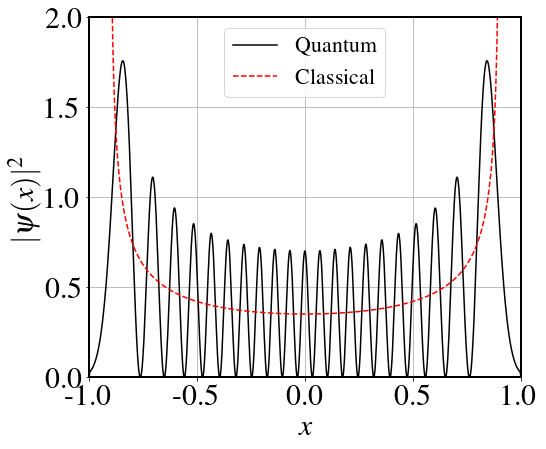

In [142]:
Psi20 = SchrodingerRK2(tf=0.05, dt=0.000001, r=0.075, L=1, omega=50, n=20)[0]
x = SchrodingerRK2(tf=0.05, dt=0.000001, r=0.075, L=1, omega=50, n=20)[4]
A = np.sqrt((2/50)*(20 + 1/2))
fig = plt.figure(figsize=(6,5))
ax1 = fig.add_axes([0,0,1,1])

ax1.plot(x , np.abs(Psi20[:,0])**2, label='Quantum', color='black')
ax1.plot(x, (1/np.pi)*(1/(np.sqrt(A**2 - x**2))), linestyle='dashed', label='Classical', color='red')
ax1.set_xlabel(r'$x$', fontsize=30)
ax1.set_ylabel(r'$|\psi(x)|^2$', fontsize=30)
ax1.grid()
ax1.set_xlim(-1,1)
ax1.set_ylim(0,2)
ax1.set_yticks([0, 0.5, 1, 1.5, 2])
ax1.set_yticklabels(['0.0', '0.5', '1.0', '1.5', '2.0'], fontsize=30)
ax1.set_xticklabels(['-1.0', '-0.5', '0.0', '0.5', '1.0'], fontsize=30)
ax1.legend()

plt.savefig('quantum_classical_n=20.png', dpi=500, bbox_inches='tight')

plt.show()

# Ehrenfest's Theorem and $e^{ik_0 x}$ extra term

In [113]:
Ergs = np.array([SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=0, k0=i)[2][0] for i in range(21)])

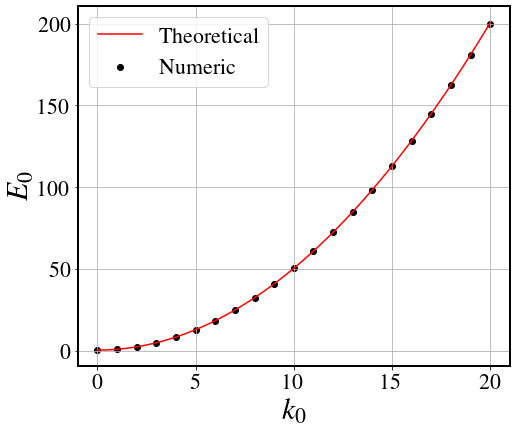

In [124]:
fig = plt.figure(figsize=(6,5))
ax = fig.add_axes([0,0,1,1])

ax.scatter(np.arange(0,21,1), Ergs.real, color='black', label='Numeric')
ax.plot(np.linspace(0,20,1000), (1/2)*(np.linspace(0,20,1000))**2 + (1/2), color='red', label='Theoretical' )
ax.set_xlabel(r'$k_0$', fontsize=30)
ax.set_ylabel(r'$E_0$', fontsize=30)
ax.legend()
ax.grid()
plt.savefig('E0_vs_k0.png', dpi=300, bbox_inches='tight')
plt.show()

In [106]:
Ergs0 = np.array([SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=i, k0=0)[2][0] for i in range(8)])
Ergs1 = np.array([SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=i, k0=1)[2][0] for i in range(8)])
Ergs2 = np.array([SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=i, k0=2)[2][0] for i in range(8)])
Ergs3 = np.array([SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=i, k0=3)[2][0] for i in range(8)])
Ergs4 = np.array([SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=i, k0=4)[2][0] for i in range(8)])
Ergs5 = np.array([SchrodingerRK2(tf=0.05, dt=0.00001, r=0.075, L=5, omega=1, n=i, k0=5)[2][0] for i in range(8)])

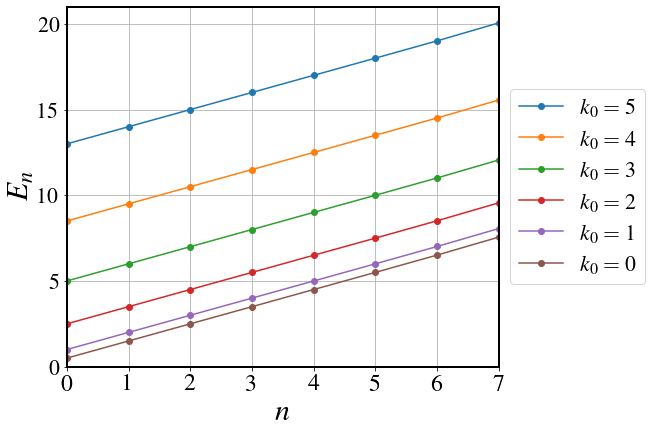

In [123]:
fig = plt.figure(figsize=(6,5))
ax = fig.add_axes([0,0,1,1])

ax.plot(np.arange(0,8,1), Ergs5.real, 'o-', label=r'$k_0=5$')
ax.plot(np.arange(0,8,1), Ergs4.real, 'o-', label=r'$k_0=4$')
ax.plot(np.arange(0,8,1), Ergs3.real, 'o-', label=r'$k_0=3$')
ax.plot(np.arange(0,8,1), Ergs2.real, 'o-', label=r'$k_0=2$')
ax.plot(np.arange(0,8,1), Ergs1.real, 'o-', label=r'$k_0=1$')
ax.plot(np.arange(0,8,1), Ergs0.real, 'o-', label=r'$k_0=0$')

ax.set_xlabel(r'$n$', fontsize=30)
ax.set_ylabel(r'$E_n$', fontsize=30)
ax.set_xlim(0,7)
ax.set_ylim(0,21)
ax.set_xticks([0,1,2,3,4,5,6,7])
ax.set_xticklabels([0,1,2,3,4,5,6,7], fontsize=24)
ax.legend(loc='center left', bbox_to_anchor=(1,0.5))
ax.grid()

plt.savefig('k0_vs_energy.png', dpi=500, bbox_inches='tight')

plt.show()

Ehrenfest's Theorem states that the mean-values of $x$ and $y$ evolve in time as

$$ \overline{x}_t = \overline{x}_0 \cos (\omega t) + \frac{1}{\omega} \overline{p}_0 \sin(\omega t) $$

and

$$ \overline{p}_t = \overline{p}_0 \cos (\omega t) + \omega \overline{x}_0 \sin(\omega t) $$

In [272]:
Psi0 = SchrodingerRK2(tf=0.5, dt=0.00001, r=0.075, L=1, omega=20, n=0, k0=20)[0]
x = SchrodingerRK2(tf=0.5, dt=0.00001, r=0.075, L=1, omega=20, n=0, k0=20)[4]
t = SchrodingerRK2(tf=0.5, dt=0.00001, r=0.075, L=1, omega=20, n=0, k0=20)[5]

In [273]:
dx = np.sqrt(1e-5/(2*0.075))
omega = 20

mean_x0 = np.trapz(np.conjugate(Psi0[:,0])*x*Psi0[:,0], dx = dx )

diff_Psi = np.gradient(Psi0[:,0], dx )
mean_p0 = np.trapz(np.conjugate(Psi0[:,0])*(-1j)*diff_Psi, dx=dx)

X = mean_x0.real*np.cos(omega*t) + (1/omega)*mean_p0.real*np.sin(omega*t)
P = (mean_p0.real*np.cos(omega*t) - omega*mean_x0.real*np.sin(omega*t))/omega

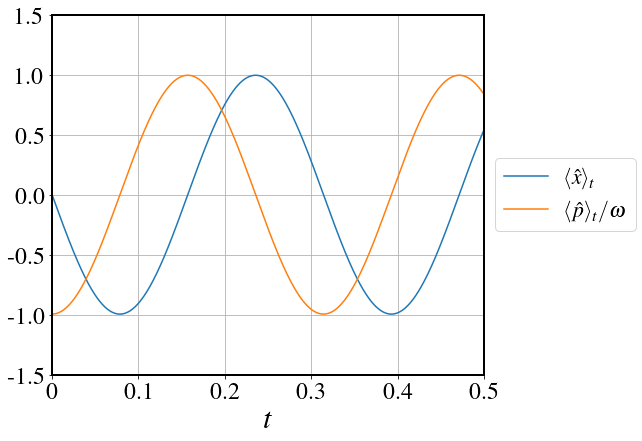

In [274]:
fig = plt.figure(figsize=(6,5))
ax = fig.add_axes([0,0,1,1])

ax.plot(t , X, label=r'$\langle \hat{x} \rangle_t$')
ax.plot(t , P, label=r'$\langle \hat{p} \rangle_t/\omega$' )
ax.set_xlim(0,0.5)
ax.set_ylim(-1.5,1.5)
ax.set_xlabel(r'$t$', fontsize=30)
ax.grid()
ax.legend(loc='center left', bbox_to_anchor=(1,0.5))
ax.set_xticks([0, 0.1, 0.2, 0.3, 0.4, 0.5])
ax.set_xticklabels([0, 0.1, 0.2, 0.3, 0.4, 0.5], fontsize=24)
ax.set_yticks([-1.5, -1.0, -0.5, 0.0, 0.5, 1.0, 1.5])
ax.set_yticklabels([-1.5, -1.0, -0.5, 0.0, 0.5, 1.0, 1.5], fontsize=24)
plt.savefig('ehrenfest.png', dpi=500, bbox_inches='tight')
plt.show()

In [32]:
mean_x0

(5.692371365939586e-10+0j)

In [33]:
mean_p0

0j

# Plots teóricos

<ipython-input-299-1b7ac2c5f58e>:2: RuntimeWarning: divide by zero encountered in true_divide
  y = (1/np.pi)*(1/(np.sqrt(1 - x**2)))


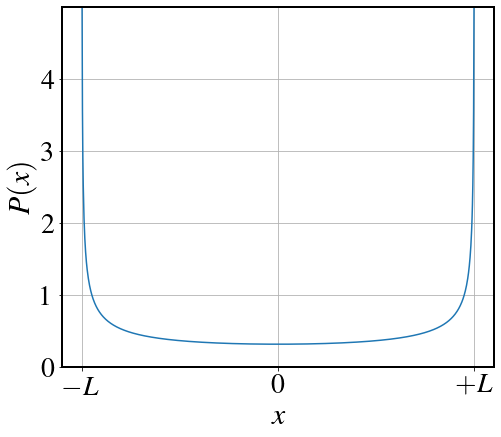

In [299]:
x = np.linspace(-1,1,1000)
y = (1/np.pi)*(1/(np.sqrt(1 - x**2)))

fig = plt.figure(figsize=(6,5))
ax1 = fig.add_axes([0,0,1,1])
ax1.plot(x, y)
ax1.set_xlabel(r'$x$',fontsize=30)
ax1.set_ylabel(r'$P(x)$', fontsize=30)
ax1.set_xticks([-1,0,1])
ax1.set_xticklabels([r'$-L$', '0' , r'$+L$'], fontsize=28)
ax1.set_yticks([0, 1, 2, 3, 4])
ax1.set_yticklabels([0, 1, 2, 3, 4], fontsize=28)
ax1.set_xlim(-1.1,1.1)
ax1.set_ylim(0,5)
ax1.grid()

plt.savefig('pdf_classical.png', dpi=500, bbox_inches='tight')

plt.show()

# Generating animation with Gaussian packet

(Psi, N, E, V, x, t, xsize, tsize)

In [289]:
Psi, N, E, V, x, t, xsize, tsize = SchrodingerRK2(tf=0.125, dt=0.00001, r=0.075, L=1, omega=50, n=0, k0=10)

In [290]:
dx = np.sqrt(5e-5/(2*0.075))
omega = 50

mean_x0 = np.trapz(np.conjugate(Psi[:,0])*x*Psi[:,0], dx = dx )

diff_Psi = np.gradient(Psi[:,0], dx )
mean_p0 = np.trapz(np.conjugate(Psi[:,0])*(-1j)*diff_Psi, dx=dx)
X = mean_x0.real*np.cos(omega*t) - (1/omega)*mean_p0.real*np.sin(omega*t)

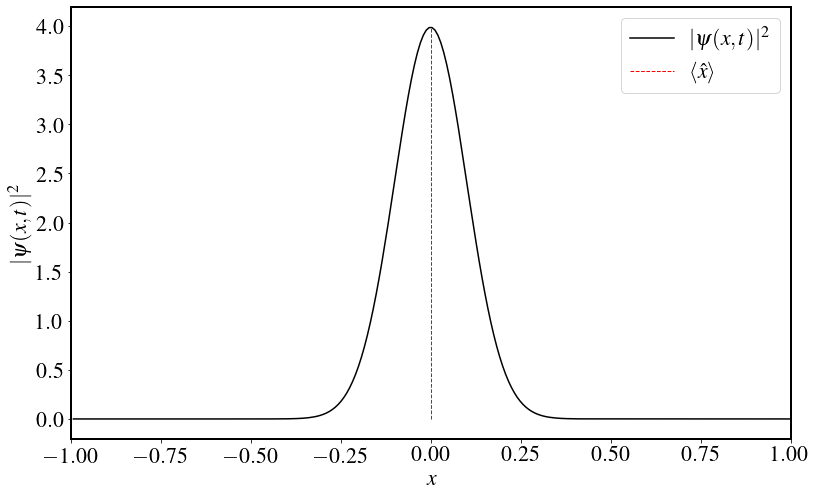

In [306]:
#import matplotlib.pyplot as plt
#from matplotlib import rcParams
from matplotlib.animation import FuncAnimation
from matplotlib.animation import PillowWriter

tf = 0.125
dt = 1e-5

mpl.rcParams['animation.embed_limit'] = 2**128
#fig, ax = plt.subplots(nrows=1, ncols=2, dpi=150, figsize=(10,6))
fig = plt.figure(figsize=(10,6))
ax = fig.add_axes([0,0,1,1])
pico = np.max(np.abs(Psi[:, 0])**2)
step = int(tsize/300)
time = np.arange(0, tf, dt)

def animate(i):
    
    ax.clear()
    ax.clear()
    ax.plot(x, np.abs(Psi[:, step*i])**2, label=r'$| \psi (x, t) |^2$', color='black')
    ax.vlines(x=np.real(X[step*i]), ymin=0, ymax=np.max(np.abs(Psi[:, step*i])**2), color='red', 
              ls='--', lw=1, label=r'$\langle \hat{x} \rangle$')
    ax.set_xlabel(r'$x$')
    ax.set_ylabel(r'$| \psi (x, t) |^2$')
    ax.set_xlim(-1, 1)
    ax.set_ylim(-0.2, 4.2)
    ax.legend()
    
ani = FuncAnimation(fig, animate, frames=int(tsize/step), interval=33, repeat=False)

f = r'x_mean_animation.gif'
writergif = PillowWriter(fps=30) 
ani.save(f, writer=writergif)

from IPython.display import HTML
HTML(ani.to_jshtml())

In [292]:
Psi1, N1, E1, V1, x1, t1, xsize1, tsize1 = SchrodingerRK2(tf=0.125, dt=0.00001, r=0.075, L=1, omega=50, n=1, k0=0)

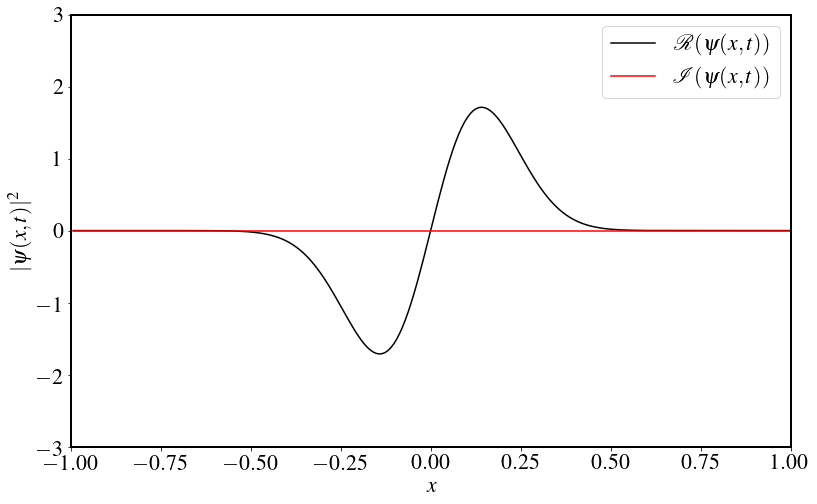

In [307]:
tf = 0.125
dt = 1e-5

mpl.rcParams['animation.embed_limit'] = 2**128
fig = plt.figure(figsize=(10,6))
ax = fig.add_axes([0,0,1,1])
pico = np.max(np.abs(Psi1[:, 0])**2)
step = int(tsize1/300)
time = np.arange(0, tf, dt)

def animate(i):
    
    ax.clear()
    ax.clear()
    ax.plot(x, Psi1[:, step*i].real, label=r'$\mathcal{R}(\psi(x,t))$', color='black')
    ax.plot(x, Psi1[:, step*i].imag, label=r'$\mathcal{I}(\psi(x,t))$', color='red')
    ax.set_xlabel(r'$x$')
    ax.set_ylabel(r'$| \psi (x, t) |^2$')
    ax.set_xlim(-1, 1)
    ax.set_ylim(-3, 3)
    ax.legend()

ani = FuncAnimation(fig, animate, frames=int(tsize1/step), interval=33, repeat=False)
# f = r'xmean_oscillation.mp4' 
# writervideo = FFMpegWriter(fps=30) 
# ani.save(f, writer=writervideo, dpi=500)

f = r'wave_function.gif'
writergif = PillowWriter(fps=30) 
ani.save(f, writer=writergif)

from IPython.display import HTML
HTML(ani.to_jshtml())

# Initial state as a linear combination of eigenstates

In [341]:
def psi0(omega, x, n):
    hermite_pol = special.hermite(n, monic=False)
    return (1/np.sqrt(2**n*special.factorial(n)))*\
            (omega/np.pi)**(1/4)*np.exp(-omega*x**2/2)*hermite_pol(np.sqrt(omega)*x)

def SchrodingerRK2(tf, dt, r, L, omega, n, k0):
    
    dx = np.sqrt(dt/(2*r))
    x = -np.arange(-L,L,dx)
    t = np.arange(0,tf+dt,dt)
    tsize = len(t) ; xsize = len(x) 

    R = np.zeros( (xsize,tsize) ) #Parte real
    I = np.zeros( (xsize,tsize) ) #Parte complexa
    Psi = np.zeros( (xsize,tsize), dtype=np.complex64 )
    V = (1/2)*(omega*x)**2
    
    k1I = np.zeros( xsize ) # k1 da parte imaginaria
    k1R = np.zeros( xsize ) # k1 da parte real
    k2I = np.zeros( xsize ) # k2 da parte imaginaria
    k2R = np.zeros( xsize ) # k2 da parte real

    #valores de meio passo
    R12 = np.zeros(xsize)
    I12 = np.zeros(xsize)
    
    #parte real e imaginaria da hamiltoniana para posterior calculo da energia
    HR = np.zeros( (xsize, tsize) )
    HI = np.zeros( (xsize, tsize) )

    E = np.zeros(tsize, dtype=np.complex64)

    N = np.zeros(tsize) # Integral mostrando a normalizacao
    
    #definindo as condicoes iniciais da funcao de onda
    Psi[:,0] = (psi0(omega, x, 0)*np.exp(1j*k0*x) + psi0(omega, x, 1) + psi0(omega, x, 2))/np.sqrt(3)
    R[:,0] = Psi[:,0].real
    I[:,0] = Psi[:,0].imag
    
    #loop no tempo para Runge Kutta
    for n in range(tsize-1):
        #impondo as condicoes de contorno
        I[0,:]  = 0
        I[-1,:] = 0
        R[0,:]  = 0
        R[-1,:] = 0
        
        #normalmente utiliza-se um loop espacial alem do loop temporal, mas utilizando
        #slicing de arrays, é possivel evitar os loops espaciais, otimizando o algoritmo
        
        #calculando os k1R's
        k1R[1:-1] = -r*(I[2:,n] - 2*I[1:-1, n] + I[:-2, n]) + V[1:-1]*I[1:-1,n]*dt
        k1R[0]    = -r*(I[1,n] - 2*I[0,n] + I[-1,n]) + V[0]*I[0,n]*dt
        k1R[-1]   = -r*(I[0,n] - 2*I[-1,n] + I[-2,n]) + V[-1]*I[-1,n]*dt
        
        #calculando os k1I's
        k1I[1:-1] = +r*(R[2:,n] - 2*R[1:-1,n] + R[:-2,n] ) - V[1:-1]*R[1:-1,n]*dt
        k1I[0]    = +r*(R[1,n] - 2*R[0,n] + R[-1,n]) - V[0]*R[0,n]*dt
        k1I[-1]   = +r*(R[0,n] - 2*R[-1,n] + R[-2,n]) - V[-1]*R[-1,n]*dt
        
        #calculando os valores de meio passo
        R12       = R[:,n] + k1R/2
        I12       = I[:,n] + k1I/2
        
        #calculando k2R's
        k2R[1:-1] = -r*(I12[2:] - 2*I12[1:-1] + I12[:-2]) + V[1:-1]*I12[1:-1]*dt
        k2R[0]    = -r*(I12[1] - 2*I12[0] + I12[-1]) + V[0]*I12[0]*dt
        k2R[-1]   = -r*(I12[0] - 2*I12[-1] + I12[-2]) + V[-1]*I12[-1]*dt
        
        #calculando k2I's
        k2I[1:-1] = +r*(R12[2:] - 2*R12[1:-1] + R12[:-2]) - V[1:-1]*R12[1:-1]*dt
        k2I[0]    = +r*(R12[1] - 2*R12[0] + R12[-1]) - V[0]*R12[0]*dt
        k2I[-1]   = +r*(R12[0] - 2*R12[-1] + R12[-2]) - V[-1]*R12[-1]*dt 
        
        #calculando as iteracoes de R e I
        R[:,n+1] = R[:,n] + k2R
        I[:,n+1] = I[:,n] + k2I
        R[:,-1]  = R[:,-2] + k2R
        I[:,-1]  = I[:,-2] + k2I
        
        #reimpondo as condicoes de contorno
        I[0,:]   = 0
        I[-1,:]  = 0
        R[0,:]   = 0
        R[-1,:]  = 0

        #calculando HI
        HR[1:-1,n] = -(1/(2*dx**2))*( R[2:,n] - 2*R[1:-1,n] + R[:-2,n] ) + V[1:-1]*R[1:-1,n]
        HR[-1,n]   = -(1/(2*dx**2))*( R[0,n] - 2*R[-1,n] + R[-2,n] ) + V[-1]*R[-1,n]
        HR[0,n]    = -(1/(2*dx**2))*( R[1,n] - 2*R[0,n] + R[-1,n] ) + V[0]*R[0,n]
        
        #calculando HR
        HI[1:-1,n] = -(1/(2*dx**2))*( I[2:,n] - 2*I[1:-1,n] + I[:-2,n] ) + V[1:-1]*I[1:-1,n]
        HI[0,n]    = -(1/(2*dx**2))*( I[-1,n] - 2*I[0,n] + I[1,n] ) + V[0]*I[0,n]
        HI[-1,n]   = -(1/(2*dx**2))*( I[-2,n] - 2*I[-1,n] + I[0,n] ) + V[-1]*I[-1,n]

    #calculando HR no ultimo termo temporal
    HR[1:-1,-1] = -(1/2)*((R[2:,-1] - 2*R[1:-1,-1] + R[:-2,-1])/(dx**2)) + V[1:-1]*R[1:-1,-1]
    HR[0,-1]    = -(1/2)*((R[1,n] - 2*R[0,-1] + R[-1,-1])/(dx**2)) + V[0]*R[0,-1]
    HR[-1,-1]   = -(1/2)*((R[0,n] - 2*R[-1,-1] + R[-2, -1])/(dx**2)) + V[-1]*R[-1,-1]
    
    #calculando HI no ultimo termo temporal
    HI[1:-1,-1] = -(1/2)*((I[2:,-1] - 2*I[1:-1,-1] + I[:-2,-1])/(dx**2)) + V[1:-1]*I[1:-1,-1]
    HI[0,-1]    = -(1/2)*((I[1,-1] - 2*I[0,-1] + I[-1,-1])/(dx**2)) + V[0]*I[0,-1]
    HI[-1,-1]   = -(1/2)*((I[0,-1] - 2*I[-1,-1] + I[-2,-1])/(dx**2)) + V[-1]*I[-1,-1]
    
    #definindo a funcao de onda a partir da parte real R e imaginaria I
    Psi = R + 1j*I
    
    #calculando a normalizacao da funcao de onda
    N = np.trapz(np.abs(Psi)**2, dx=dx, axis=0)
    
    #calculando a energia a partir da funcao de onda e das hamiltonianas
    E = np.trapz(np.conjugate(Psi)*(HR + 1j*HI), dx=dx, axis=0 ) / N
    
    return (Psi, N, E, V, x, t, xsize, tsize)

In [349]:
Psi, N, E, V, x, t, xsize, tsize = SchrodingerRK2(tf=0.125, dt=1e-5, r=0.075, L=1, omega=50, n=0, k0=0)

In [350]:
N

array([0.99999999, 0.99999999, 0.99999999, ..., 1.00000165, 1.00000165,
       1.00000165])

In [365]:
N[0]-N[-1]

-1.6630490167202083e-06

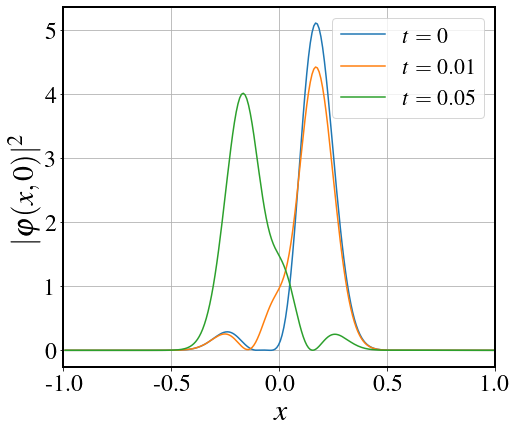

In [364]:
fig = plt.figure(figsize=(6,5))
ax = fig.add_axes([0,0,1,1])

ax.plot(x, np.abs(Psi[:,0])**2, label=r'$t=0$')
ax.plot(x, np.abs(Psi[:,1000])**2, label=r'$t=0.01$')
ax.plot(x, np.abs(Psi[:,5000])**2, label=r'$t=0.05$')
ax.set_xlabel(r'$x$',fontsize=30)
ax.set_ylabel(r'$|\varphi(x,0)|^2$',fontsize=30)
ax.set_xlim(-1,1)
ax.set_xticks([-1,-.5,0,.5,1])
ax.set_xticklabels([-1.0, -0.5, 0.0, 0.5, 1.0],fontsize=24)
ax.set_yticks([0,1,2,3,4,5])
ax.set_yticklabels([0,1,2,3,4,5],fontsize=24)
ax.grid()
ax.legend()
plt.savefig('CL-eigens-pdf.png', dpi=500, bbox_inches='tight')
plt.show()

In [362]:
t[5000]

0.05

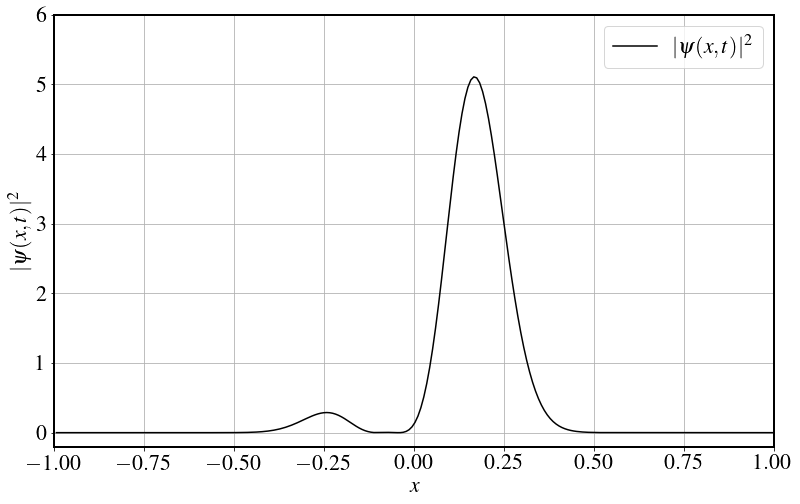

In [368]:
tf = 0.125
dt = 1e-5

mpl.rcParams['animation.embed_limit'] = 2**128
fig = plt.figure(figsize=(10,6))
ax = fig.add_axes([0,0,1,1])
pico = np.max(np.abs(Psi[:, 0])**2)
step = int(tsize/300)
time = np.arange(0, tf, dt)

def animate(i):
    
    ax.clear()
    ax.clear()
    ax.plot(x, np.abs(Psi[:, step*i])**2, label=r'$|\psi(x,t)|^2$', color='black')
    #ax.plot(x, Psi[:, step*i].imag, label=r'$\mathcal{I}(\psi(x,t))$', color='red')
    ax.set_xlabel(r'$x$')
    ax.set_ylabel(r'$| \psi (x, t) |^2$')
    ax.set_xlim(-1, 1)
    ax.set_ylim(-0.2, 6)
    ax.legend()
    ax.grid()

ani = FuncAnimation(fig, animate, frames=int(tsize/step), interval=33, repeat=False)
# f = r'xmean_oscillation.mp4' 
# writervideo = FFMpegWriter(fps=30) 
# ani.save(f, writer=writervideo, dpi=500)

f = r'wave_function_non_stationary.gif'
writergif = PillowWriter(fps=30) 
ani.save(f, writer=writergif)

from IPython.display import HTML
HTML(ani.to_jshtml())